
# Advanced lines detection

The objective of this project is to use advanced techniques of computer vision to detect the lanes on the road.


In [1]:
%matplotlib inline

import matplotlib.pyplot as plt
from matplotlib.pyplot import imshow
import matplotlib.image as mpimage
import tensorflow as tf
import numpy as np
from sklearn.metrics import confusion_matrix
from sklearn.utils import shuffle
import time
from datetime import timedelta
import math
import pickle
import PIL.Image
import IPython.display
import matplotlib.gridspec as gridspec
import os
import cv2
import glob

# Imports to edit/save/watch video clips
from moviepy.editor import VideoFileClip
from IPython.display import HTML

## Calibration

The first step is to calibrate the camera. All cameras deformates the image in some way or another. We use a set of checkboard images to measure the distortion and calirate the camera.

In [2]:
def load_images_from_dir(dirname):
    '''
    loads the images in directory dirname and transforms to RGB format
    '''
    rs = [cv2.imread("{}/{}".format(dirname, image)) for image in os.listdir(dirname)]
    return [cv2.cvtColor(r, cv2.COLOR_BGR2RGB) for r in rs]

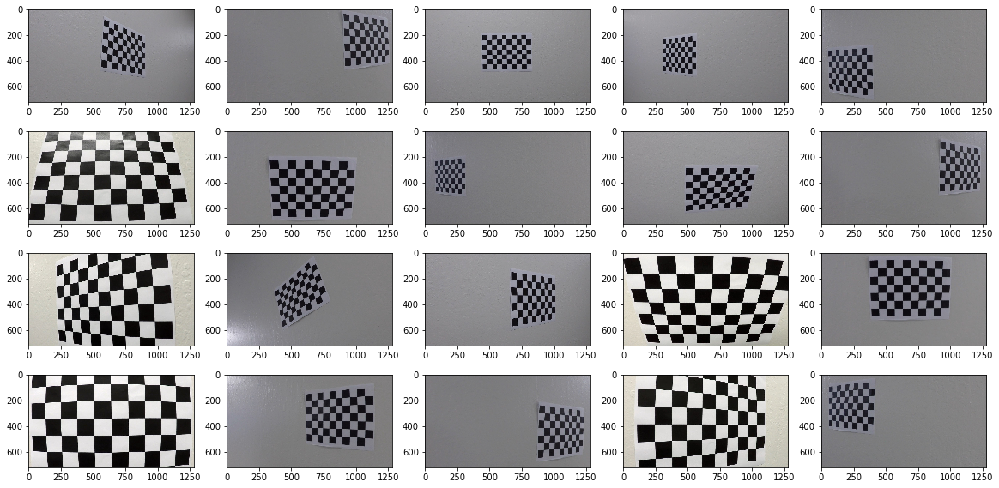

In [3]:
#set of calibration images
calibration_images = load_images_from_dir("./camera_cal")


def show_images(images, figsize, nrows=5, ncols=5, cmap=None):
    '''
    show a set of images in a grid
    '''
    fig, axes = plt.subplots(nrows=nrows, ncols=ncols, figsize=figsize)
    for image, ax in zip(images,axes.flat):
        ax.imshow(image, cmap=cmap)
        
#shows the set of calibration images
show_images(calibration_images, figsize=(20,10), nrows=4)

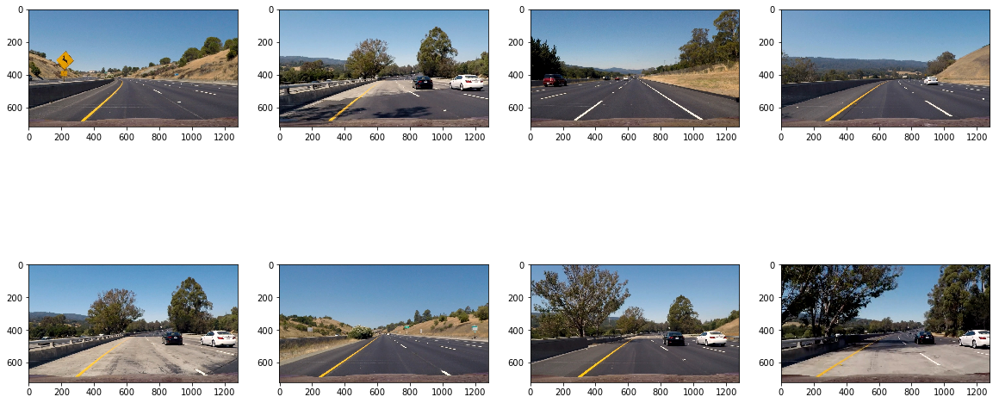

In [4]:
#test images
test_images = load_images_from_dir("./test_images")

#show the set of test images
show_images(test_images, figsize=(20,10), nrows=2, ncols=4)

### Measuring distortion

We measure the distortion using cv2 function findChessboardCorners. We use this functions to deect the checkboard corners and the distortion.

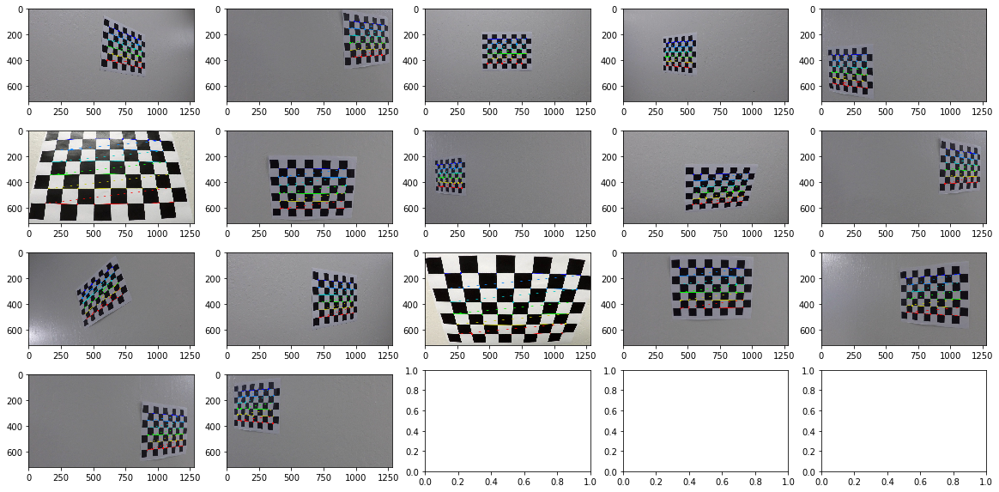

In [5]:
def calibrate_images(images, nx=9,ny=6):
    '''
    calibrate a set of checkboard images. 
    nx is the number of corners in x direction.
    ny is the number of corners in y direction.
    '''
    # termination criteria
    criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 30, 0.001)

    # prepare object points, like (0,0,0), (1,0,0), (2,0,0) ....,(6,5,0)
    objp = np.zeros((nx*ny,3), np.float32)
    objp[:,:2] = np.mgrid[0:nx,0:ny].T.reshape(-1, 2)

    # Arrays to store object points and image points from all the images.
    objpoints = [] # 3d point in real world space
    imgpoints = [] # 2d points in image plane.
    rs_images = [] # result images

    for img in images:
        gray = cv2.cvtColor(img,cv2.COLOR_RGB2GRAY)

        # Find the chess board corners
        ret, corners = cv2.findChessboardCorners(gray, (nx,ny),None)

        # If found, add object points, image points (after refining them)
        if ret == True:
            objpoints.append(objp)

            corners2 = cv2.cornerSubPix(gray,corners,(11,11),(-1,-1),criteria)
            imgpoints.append(corners2)

            # Draw and display the corners
            img = cv2.drawChessboardCorners(img, (nx,ny), corners2,ret)
            rs_images.append(img)
    return objpoints, imgpoints, rs_images

objpoints, imgpoints, calibrated_images = calibrate_images(calibration_images)

#we show the checkboard images already calibrated.
show_images(calibrated_images, figsize=(20,10), nrows=4)

In [6]:
#parameters of camera calibration
ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, calibration_images[0].shape[1::-1],None,None)

In [7]:
def undistord_image(image):
    '''
    using the previous parameters of camera calibration returns an undistorted version of the image.
    '''
    return cv2.undistort(image, mtx, dist, None, mtx)



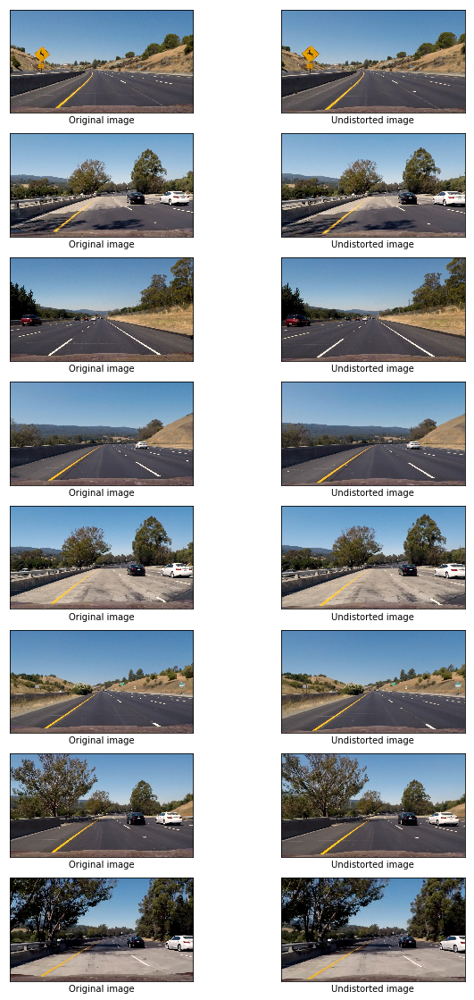

In [8]:
def show_undistorted_images(original_images):
    undistorted_images = [undistord_image(image) for image in original_images]
    fig, axes = plt.subplots(len(original_images), 2, figsize=(10, 20))
    #fig.subplots_adjust(hspace=4, wspace=6)
    images = list(zip(original_images, undistorted_images))
    j=0
    for i, ax in enumerate(axes.flat):
        # Plot image.
        if i%2==0:
            ax.imshow(original_images[j])
            ax.set_xlabel('Original image')
        else:
            ax.imshow(undistorted_images[j])
            ax.set_xlabel('Undistorted image')
            j +=1
        ax.set_xticks([], [])
        ax.set_yticks([], [])
    
    # Ensure the plot is shown correctly with multiple plots
    # in a single Notebook cell.
    plt.show()
    
#show test images and undistorted version
show_undistorted_images(test_images)

In [9]:
#show project video
video_input = 'project_video.mp4'
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(video_input))

In [10]:
def pipelined_video(pipeline, video_output, video_input='project_video.mp4'):
    '''
    helper video that process input video through pipeline and writes to video_output
    '''
    clip1 = VideoFileClip(video_input)
    white_clip = clip1.fl_image(pipeline) #NOTE: this function expects color images!!
    %time white_clip.write_videofile(video_output, audio=False)  
    return HTML("""
    <video width="960" height="540" controls>
      <source src="{0}">
    </video>
    """.format(video_output))

In [11]:
#show the project video undistorted
pipelined_video(undistord_image, 'undist_project_video.mp4')

[MoviePy] >>>> Building video undist_project_video.mp4
[MoviePy] Writing video undist_project_video.mp4


100%|█████████▉| 1260/1261 [01:23<00:00, 15.49it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: undist_project_video.mp4 

CPU times: user 2min 2s, sys: 18.2 s, total: 2min 20s
Wall time: 1min 24s


## Perspective transform

The camera is in the front of the car. We want to change the perspective to a perspective from above, so it's is more easy to detect the lane lines.

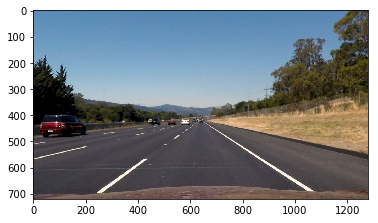

In [12]:
undistorted_test_images = [undistord_image(image) for image in test_images]
image = undistorted_test_images[2]

#show an undistorted image from the test images set.
imshow(image)

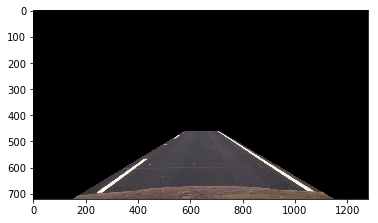

In [13]:
def region_of_interest(img, vertices):
    """
    Applies an image mask.
    
    Only keeps the region of the image defined by the polygon
    formed from `vertices`. The rest of the image is set to black.
    """
    #defining a blank mask to start with
    mask = np.zeros_like(img)   
    
    #defining a 3 channel or 1 channel color to fill the mask with depending on the input image
    if len(img.shape) > 2:
        channel_count = img.shape[2]  # i.e. 3 or 4 depending on your image
        ignore_mask_color = (255,) * channel_count
    else:
        ignore_mask_color = 255
        
    #filling pixels inside the polygon defined by "vertices" with the fill color    
    cv2.fillPoly(mask, [vertices], ignore_mask_color)
    
    #returning the image only where mask pixels are nonzero
    masked_image = cv2.bitwise_and(img, mask)
    return masked_image

# Define the region
area_of_interest = np.array([[150+430,460],[1150-440,460],[1150,720],[150,720]], dtype=np.int32)
masked_image = region_of_interest(image, area_of_interest)

#show the region of interest to process the image
imshow(masked_image)

We have selected visualy an area of interest. We use the selected area of interest to warp later the images

In [14]:
image_shape = image.shape
img_size = (image_shape[1], image_shape[0])


In [15]:
def warp_image(image, rect=[[150+430,460],[1150-440,460],[1150,720],[150,720]]):
    '''
    warp the image to change perspective.
    the rect area is the same as area of interest before.
    we add an offset to include more area around our region of interest
    '''
    # construct our destination points which will be used to
    # map the screen to a top-down, "birds eye" view
    offset1 = 200 # offset for dst points x value
    offset2 = 0 # offset for dst points bottom y value
    offset3 = 0 # offset for dst points top y value
    # Grab the image shape
    img_size = (image.shape[1], image.shape[0])
    # For destination points, I'm arbitrarily choosing some points to be
    # a nice fit for displaying our warped result 
    dst = np.float32([[offset1, offset3], 
                      [img_size[0]-offset1, offset3], 
                      [img_size[0]-offset1, img_size[1]-offset2], 
                      [offset1, img_size[1]-offset2]])
    
    src = np.float32(rect)
 
    # calculate the perspective transform matrix and warp
    # the perspective to grab the screen
    M = cv2.getPerspectiveTransform(src, dst)
    Minv = cv2.getPerspectiveTransform(dst, src)
    warp = cv2.warpPerspective(image, M, img_size)
    return warp, M, Minv

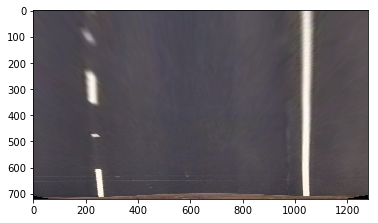

In [16]:
#show a warped image.Now we have a perspective from above
imshow(warp_image(image)[0])

In [17]:
def pipeline_warped(image):
    '''
    this pipeline includes undistord image and warp image
    '''
    image = undistord_image(image)
    image = warp_image(image)[0]
    return image

In [18]:
#show the warped video
pipelined_video(pipeline_warped, 'warped_project_video.mp4')

[MoviePy] >>>> Building video warped_project_video.mp4
[MoviePy] Writing video warped_project_video.mp4


100%|█████████▉| 1260/1261 [02:55<00:00,  7.20it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: warped_project_video.mp4 

CPU times: user 8min 27s, sys: 29.7 s, total: 8min 57s
Wall time: 2min 57s


In [19]:
# Sharpen image
def sharpen_image(img, s=1.0):
    gb = cv2.GaussianBlur(img, (5,5), 20.0)
    img = cv2.addWeighted(img, 2, gb, -1, 0)
    return img

# Compute linear image transformation img*s+m
def lin_img(img,s=1.0,m=0.0):
    img2=cv2.multiply(img, np.array([s]))
    return cv2.add(img2, np.array([m]))


In [20]:
def pipeline_sharped(image):
    '''
    we add a gaussian blur and sharpen image to improve image quality for computer vision
    '''
    image = undistord_image(image)
    image = warp_image(image)[0]
    image = sharpen_image(image)
    return image

In [21]:
#show the sharped video
pipelined_video(pipeline_sharped, 'sharped_project_video.mp4')

[MoviePy] >>>> Building video sharped_project_video.mp4
[MoviePy] Writing video sharped_project_video.mp4


100%|█████████▉| 1260/1261 [03:07<00:00,  6.71it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: sharped_project_video.mp4 

CPU times: user 9min 5s, sys: 32.4 s, total: 9min 37s
Wall time: 3min 9s


## Color mask

To help us to find the lanes lines we filter the image. In this section we apply the color filter. We filter the white and yellow colors. 

For the white filter we use and rgb filter box between gray (200,200,200) and white (255,255,255)

For the yellow filter we transform the image to hsv and appy a minimum and maximum threshold.

In [22]:
def mask_white_or_yellow(image):
    """
    Filter the image to include only yellow and white pixels
    """
    # Filter white pixels
    white_threshold = 200 #130
    lower_white = np.array([white_threshold, white_threshold, white_threshold])
    upper_white = np.array([255, 255, 255])
    white_mask = cv2.inRange(image, lower_white, upper_white)
    white_image = cv2.bitwise_and(image, image, mask=white_mask)

    # Filter yellow pixels
    hsv = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)
    #parameters obtained manualy. The previous conversion was from BGR image that was encoded as RGB
    lower_yellow = np.array([90,100,100])
    upper_yellow = np.array([110,255,255])
    yellow_mask = cv2.inRange(hsv, lower_yellow, upper_yellow)
    yellow_image = cv2.bitwise_and(image, image, mask=yellow_mask)
    
    return cv2.bitwise_or(white_image, yellow_image)

    # Combine the two above images
    image2 = cv2.addWeighted(white_image, 1., yellow_image, 1., 0.)

    return image2

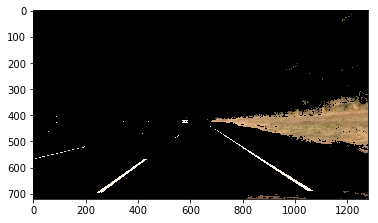

In [23]:
#show image filtered by color white and yellow
imshow(mask_white_or_yellow(image), cmap='gray')

In [24]:
def pipeline_color(image):
    '''
    in this pipeline we include the color filter
    '''
    image = undistord_image(image)
    image = warp_image(image)[0]
    image = sharpen_image(image)
    image = mask_white_or_yellow(image)
    return image

#show the video after applying the color filter
pipelined_video(pipeline_color, 'color_project_video.mp4')

[MoviePy] >>>> Building video color_project_video.mp4
[MoviePy] Writing video color_project_video.mp4


100%|█████████▉| 1260/1261 [02:28<00:00,  9.69it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: color_project_video.mp4 

CPU times: user 7min 26s, sys: 22.7 s, total: 7min 49s
Wall time: 2min 29s


## Gradient threshold

At the same time of the color filter we apply the gradient filter. Applying the sobel function to the x axis we detect the gradient changes. We use that to detect the lane lines.

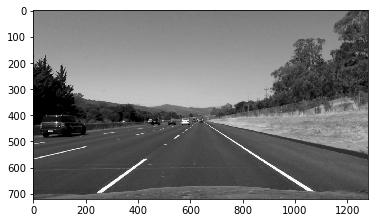

In [25]:
#show image in grayscale
gray = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
imshow(gray, cmap='gray')

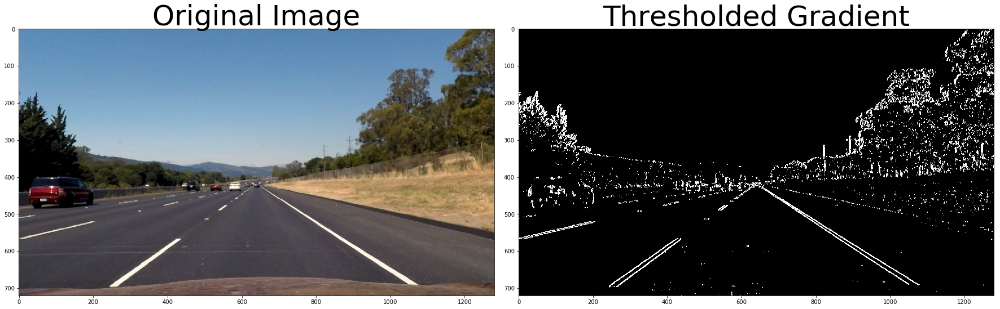

In [26]:
import matplotlib.image as mpimg


# Read in an image and grayscale it
#image = mpimg.imread('signs_vehicles_xygrad.png')

# Define a function that applies Sobel x or y, 
# then takes an absolute value and applies a threshold.
# Note: calling your function with orient='x', thresh_min=5, thresh_max=100
# should produce output like the example image shown above this quiz.
# Define a function that takes an image, gradient orientation,
# and threshold min / max values.
def abs_sobel_thresh(img, orient='x', thresh_min=0, thresh_max=255):
    # Convert to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS).astype(np.float)
    #h_channel = hls[:,:,0]
    gray = hls[:,:,1]
    # Apply x or y gradient with the OpenCV Sobel() function
    # and take the absolute value
    if orient == 'x':
        abs_sobel = np.absolute(cv2.Sobel(gray, cv2.CV_64F, 1, 0))
    if orient == 'y':
        abs_sobel = np.absolute(cv2.Sobel(gray, cv2.CV_64F, 0, 1))
    # Rescale back to 8 bit integer
    scaled_sobel = np.uint8(255*abs_sobel/np.max(abs_sobel))
    # Create a copy and apply the threshold
    binary_output = np.zeros_like(scaled_sobel)
    # Here I'm using inclusive (>=, <=) thresholds, but exclusive is ok too
    binary_output[(scaled_sobel >= thresh_min) & (scaled_sobel <= thresh_max)] = 1

    # Return the result
    return binary_output


def sobel_transform(image):
    """
    apply the sobel thresh function with the desired threshold.
    """
    return abs_sobel_thresh(image, orient='x', thresh_min=20, thresh_max=255)
    #return abs_sobel_thresh(image, orient='x', thresh_min=20, thresh_max=100)
    
# Run the function
grad_binary = sobel_transform(image)
# Plot the result
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(image)
ax1.set_title('Original Image', fontsize=50)
ax2.imshow(grad_binary, cmap='gray')
ax2.set_title('Thresholded Gradient', fontsize=50)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)


In [27]:
def mask_gradient_and_color(image):
    """
    apply gradient and color mask
    """
    color = mask_white_or_yellow(image)
    grad = sobel_transform(image)
    grad_and_color = cv2.bitwise_and(color, color, mask=grad)
    return grad_and_color

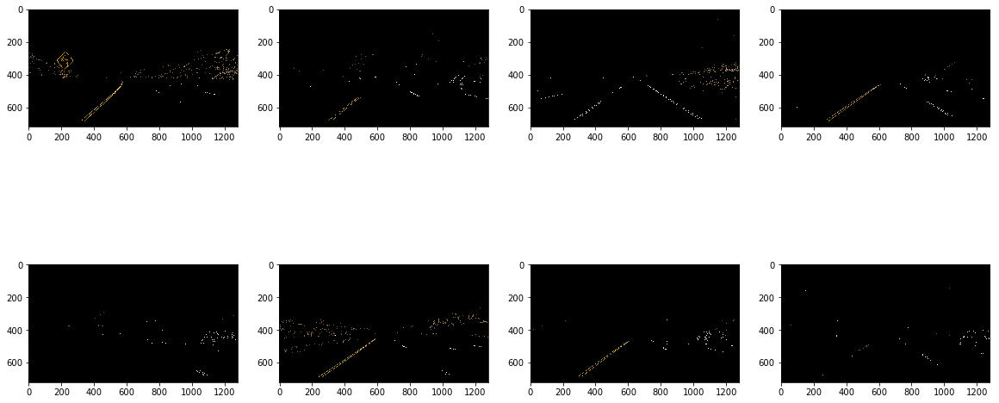

In [28]:
#show test images through the gradient and color mask.
show_images( [mask_gradient_and_color(image) for image in test_images], figsize=(20,10), nrows=2, ncols=4)

In [29]:
def pipeline_grad_and_color(image):
    """
    include in the pipeline the gradient and color mask
    """
    image = undistord_image(image)
    image = warp_image(image)[0]
    image = sharpen_image(image)
    image = mask_gradient_and_color(image)
    return image



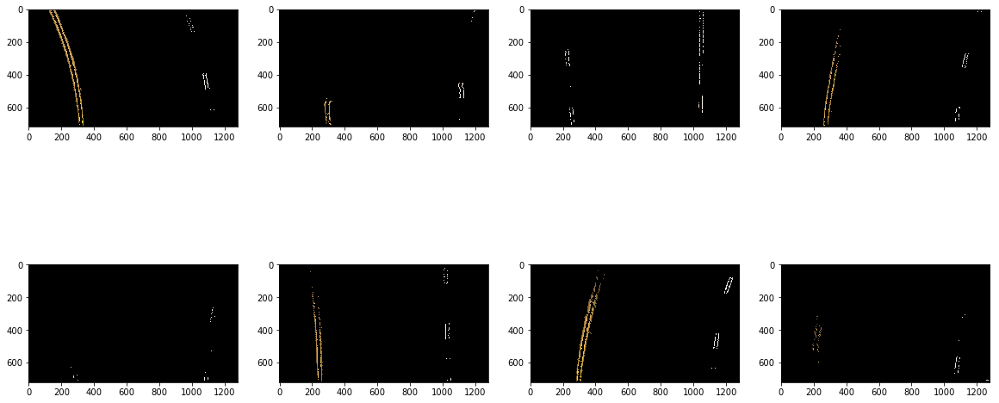

In [30]:
#show the test images through the gradient and color mask.
#we check visually the presence of points to be able to draw the lines.
show_images( [pipeline_grad_and_color(image) for image in test_images], figsize=(20,10), nrows=2, ncols=4)

In [31]:
#show the video through the gradient and color pipeline
#we check visualy that we don't lose the lines in the video. We adjust the parameters until we don't lose them.
pipelined_video(pipeline_grad_and_color, 'grad_and_color_project_video.mp4')

[MoviePy] >>>> Building video grad_and_color_project_video.mp4
[MoviePy] Writing video grad_and_color_project_video.mp4


100%|█████████▉| 1260/1261 [02:59<00:00,  7.78it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: grad_and_color_project_video.mp4 

CPU times: user 9min 33s, sys: 29.9 s, total: 10min 3s
Wall time: 3min


## Finding lines

After we have filtered the images to get only thelane lines we are able to compute and draw the lines.

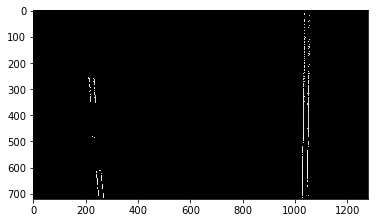

In [32]:
img = pipeline_grad_and_color(image)
imshow(img, cmap='gray')

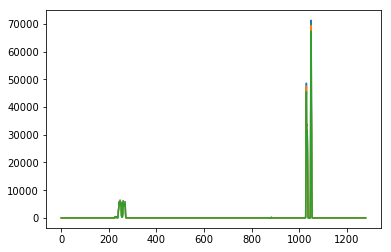

In [33]:
#from the previous image we can get the histogram
histogram = np.sum(img[img.shape[0]//2:,:], axis=0)
plt.plot(histogram)

From the histogram plot we can see the presence of two peaks. One much stronger from the other. From this two peak we can determine the lane lines.

In [34]:
def image_to_binary(image, thresh=(0, 255)):
    """
    transform the image to binary output
    """
    gray = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
    binary_output = np.zeros_like(gray)
    binary_output[(gray > thresh[0]) & (gray <= thresh[1])] = 1
    # Return the result
    return binary_output

In [35]:
def find_lines(image):
    binary_warped = image_to_binary(image)
    # Assuming you have created a warped binary image called "binary_warped"
    # Take a histogram of the bottom half of the image
    histogram = np.sum(binary_warped[binary_warped.shape[0]//2:,:], axis=0)
    # Create an output image to draw on and  visualize the result
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255
    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    midpoint = np.int(histogram.shape[0]//2)
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint

    # Choose the number of sliding windows
    nwindows = 9
    # Set height of windows
    window_height = np.int(binary_warped.shape[0]/nwindows)
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # Current positions to be updated for each window
    leftx_current = leftx_base
    rightx_current = rightx_base
    # Set the width of the windows +/- margin
    margin = 100
    # Set minimum number of pixels found to recenter window
    minpix = 50
    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []

    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = binary_warped.shape[0] - (window+1)*window_height
        win_y_high = binary_warped.shape[0] - window*window_height
        win_xleft_low = leftx_current - margin
        win_xleft_high = leftx_current + margin
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin
        # Draw the windows on the visualization image
        cv2.rectangle(out_img,(win_xleft_low,win_y_low),(win_xleft_high,win_y_high),(0,255,0), 2) 
        cv2.rectangle(out_img,(win_xright_low,win_y_low),(win_xright_high,win_y_high),(0,255,0), 2) 
        # Identify the nonzero pixels in x and y within the window
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xleft_low) & (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xright_low) & (nonzerox < win_xright_high)).nonzero()[0]
        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
        # If you found > minpix pixels, recenter next window on their mean position
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
        if len(good_right_inds) > minpix:        
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))

    # Concatenate the arrays of indices
    left_lane_inds = np.concatenate(left_lane_inds)
    right_lane_inds = np.concatenate(right_lane_inds)

    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds] 

    # Fit a second order polynomial to each
    if leftx.size>0:
        left_fit = np.polyfit(lefty, leftx, 2)
    else:
        left_fit=None
    if rightx.size>0:
        right_fit = np.polyfit(righty, rightx, 2)
    else:
        right_fit = None
    return out_img, left_fit, right_fit, nonzerox, nonzeroy,left_lane_inds,right_lane_inds

In [36]:
def visualize_lines():
    """
    plot the lines in the image
    """
    fig, axes = plt.subplots(nrows=len(test_images), ncols=2, figsize=(100, 150))
    fig.tight_layout()
    for i,image in enumerate(test_images):
        ax1 = axes.flat[2*i]
        ax2 = axes.flat[2*i+1]
        ax1.imshow(image)
        ax1.set_title('Original Image', fontsize=50)
        img = pipeline_grad_and_color(image)
        out_img, left_fit, right_fit, nonzerox,nonzeroy,left_lane_inds,right_lane_inds = find_lines(img)
        ploty = np.linspace(0, image.shape[0]-1, image.shape[0] )
        left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
        right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]

        out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
        out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]
    
        # Plot the result
        ax2.imshow(out_img)
        ax2.set_title('Box lines', fontsize=50)
        ax2.plot(left_fitx, ploty, color='yellow')
        ax2.plot(right_fitx, ploty, color='yellow')
        ax2.set_xlim(0, 1280)
        ax2.set_ylim(720, 0)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

In [37]:
#plot the images and the computed lines
#when we inspect visualy the results we can see that is very easy to lose the yellow lines when the
#background is almost white. The second image serves as an example.
visualize_lines()

In [40]:
#if we don't find the lines we use the previous line founded
previous_left_fit = None
previous_right_fit = None

def pipeline_lanes(undist):
    """
    process the image through the pipeline. 
    This pipeline includes the steps:
    - undistord image
    - warp image
    - color and gradient filter
    - find lines and plot them.
    - compute curvature and car position
    """
    global previous_left_fit, previous_right_fit
    image = undistord_image(undist)
    warped, M, Minv = warp_image( image )
    warped = image_to_binary(warped)
    img = pipeline_grad_and_color(undist)
    # Create an image to draw the lines on
    warp_zero = np.zeros_like(warped).astype(np.uint8)
    color_warp = np.dstack((warp_zero, warp_zero, warp_zero))
    out_img, left_fit, right_fit, nonzerox,nonzeroy,left_lane_inds,right_lane_inds = find_lines(img)
    ploty = np.linspace(0, warped.shape[0]-1, warped.shape[0] )
    if left_fit is not None:
        left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
        pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
        previous_left_fit = left_fit
    else:
        if previous_left_fit is not None:
            left_fitx = previous_left_fit[0]*ploty**2 + previous_left_fit[1]*ploty + previous_left_fit[2]
            pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
        else:
            pts_left = None
    if right_fit is not None:
        right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
        pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
        previous_right_fit = right_fit
    else:
        if previous_right_fit is not None:
            right_fitx = previous_right_fit[0]*ploty**2 + previous_right_fit[1]*ploty + previous_right_fit[2]
            pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
        else:
            pts_right = None
    
    # Recast the x and y points into usable format for cv2.fillPoly()
    if pts_left is not None and pts_right is not None:
        pts = np.hstack((pts_left, pts_right))
    elif pts_left is not None:
        pts = np.hstack((pts_left,))
    elif pts_right is not None:
        pts = np.hstack((pts_right,))
    else:
        pts = None

    # Draw the lane onto the warped blank image
    if pts is not None:
        cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))

    # Warp the blank back to original image space using inverse perspective matrix (Minv)
    newwarp = cv2.warpPerspective(color_warp, Minv, (image.shape[1], image.shape[0])) 
    # Combine the result with the original image
    result = cv2.addWeighted(undist, 1, newwarp, 0.3, 0)  
    
    try:
        leftx = nonzerox[left_lane_inds]
        lefty = nonzeroy[left_lane_inds] 
        rightx = nonzerox[right_lane_inds]
        righty = nonzeroy[right_lane_inds]
        y_eval = np.max(ploty)
        # Define conversions in x and y from pixels space to meters
        ym_per_pix = 30/720 # meters per pixel in y dimension
        xm_per_pix = 3.7/700 # meters per pixel in x dimension
        # Fit new polynomials to x,y in world space
        left_fit_cr = np.polyfit(lefty*ym_per_pix, leftx*xm_per_pix, 2)
        right_fit_cr = np.polyfit(righty*ym_per_pix, rightx*xm_per_pix, 2)
        # Calculate the new radii of curvature
        left_curverad = ((1 + (2*left_fit_cr[0]*y_eval*ym_per_pix + left_fit_cr[1])**2)**1.5) / np.absolute(2*left_fit_cr[0])
        right_curverad = ((1 + (2*right_fit_cr[0]*y_eval*ym_per_pix + right_fit_cr[1])**2)**1.5) / np.absolute(2*right_fit_cr[0])

        curvature = (left_curverad + right_curverad) / 2
        cv2.putText(result, "Curvature: {0:.2f}m".format(curvature), (30,60), cv2.FONT_HERSHEY_SIMPLEX, 2, (255, 255, 255), thickness=10)
    
        bottom_leftx = left_fitx[-1]
        bottom_rightx = right_fitx[-1]
    
        lane_center = (bottom_leftx + bottom_rightx) / 2
    
        car_center = 1280 / 2
    
        difference = lane_center - car_center
    
        difference_meters = difference * xm_per_pix
    
        cv2.putText(result, "{0:.2f}m left of center".format(difference_meters), (30,110), cv2.FONT_HERSHEY_SIMPLEX, 2, (255, 255, 255), thickness=10)
            
    except:
        #if we cannot compute the lines because we loose the lines show normal image
        pass
    return result

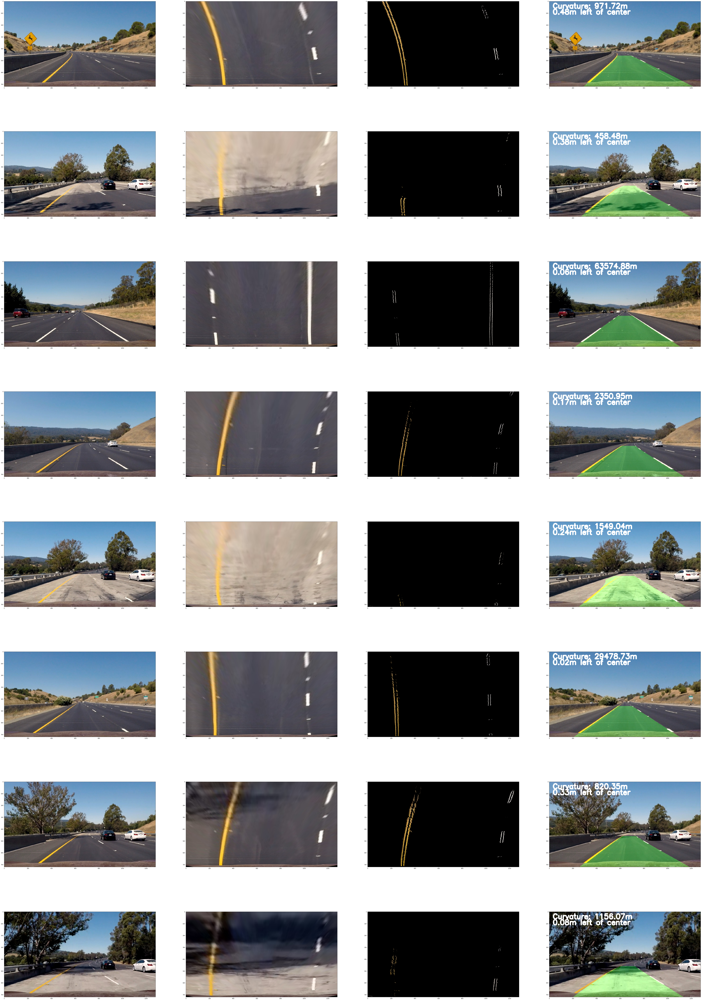

In [ ]:
def show_lanes():
    fig, axes = plt.subplots(nrows=len(test_images), ncols=4, figsize=(100, 150))
    for i,image in enumerate(test_images):
        axes.flat[4*i].imshow(image)
        axes.flat[4*i+1].imshow(warp_image(image)[0])
        axes.flat[4*i+2].imshow( pipeline_grad_and_color(image), cmap='gray')
        axes.flat[4*i+3].imshow(pipeline_lanes(image))
#show the test images through the pipeline so we can inspect visually the results.
show_lanes()

In [ ]:
previous_left_fit = previous_right_fit = None

#show the project video through the final pipeline
pipelined_video(pipeline_lanes, 'lanes_project_video.mp4')

[MoviePy] >>>> Building video lanes_project_video.mp4
[MoviePy] Writing video lanes_project_video.mp4


 97%|█████████▋| 1229/1261 [06:44<00:09,  3.26it/s]

## Conclusions

In good conditions is easy to find the lane lines. When the background color changes and there is shadows it's more dificult. This program doesn't take in accound weather conditions or daytime.
Also when computing lines is more easy to have big differences with the ground truth with the fartest points.
